In [1]:
from os import listdir
from os.path import join

from scipy.misc import imread, imsave
import numpy as np

import matplotlib.pyplot as plt
import matplotlib.cm as cm
%matplotlib inline

# Import JSAnimation 
from JSAnimation.JSAnimation import IPython_display, HTMLWriter
from matplotlib import animation
from PIL import Image
import glob

#### Leemos las imágenes e inicializamos las variables

In [2]:
IMAGES_PATH = 'imgs'
images = [imread(join(IMAGES_PATH, img_file)) for img_file in sorted(listdir(IMAGES_PATH))]
image_size = images[0].shape
background = np.zeros((len(images), image_size[0], image_size[1]))
#plt.imshow(background[-1], cmap = cm.Greys_r)

In [3]:
# Inicializar media y desviación típica
Σ = np.zeros((len(images), image_size[0], image_size[1]))
m = np.zeros((len(images), image_size[0], image_size[1]))
m[0] = images[0].astype('float')
Σ[0] = np.ones(image_size)*25

#### Algoritmo Stauffer & Grimson

In [4]:
# Actualizar los parámetros
ρ = 0.1
U = np.ones(image_size)*4
d_list = []

for t in range(1,len(images)):
    # Obtener la distancia de Mahalanobis
    d = np.sqrt(((images[t] - m[t-1])**2)/Σ[t-1])
    mask = (d <= U) 
    # Asignar el valor anterior
    m[t] = m[t-1]
    Σ[t] = Σ[t-1]
    # Actualizar sólo si es menor al umbral
    m[t][mask] = (((1 - ρ)*m[t-1]) + (ρ*images[t-1]))[mask]
    Σ[t][mask] = (((1 - ρ)*Σ[t-1]) + (ρ*((images[t-1]-m[t-1])**2)))[mask]
    
    background[t] = mask.astype(int)

#### Visualización de los resultados 

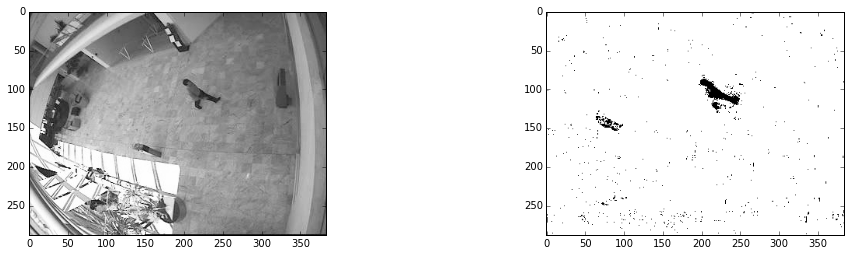

In [5]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(17, 4))
axes[0].imshow(images[-1], cmap = cm.Greys_r)
axes[1].imshow(background[-1], cmap = cm.Greys_r)


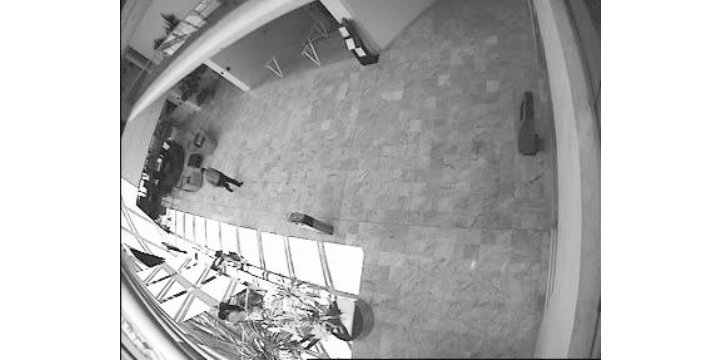
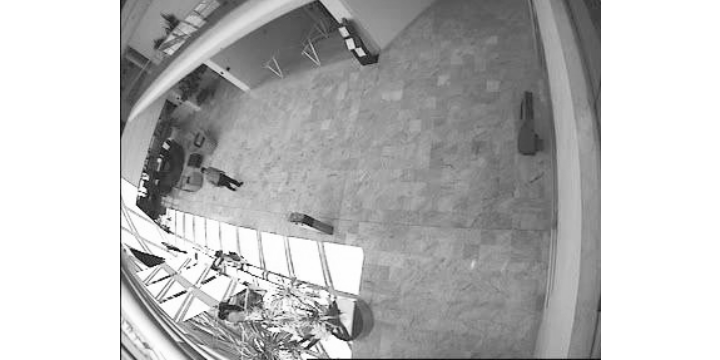
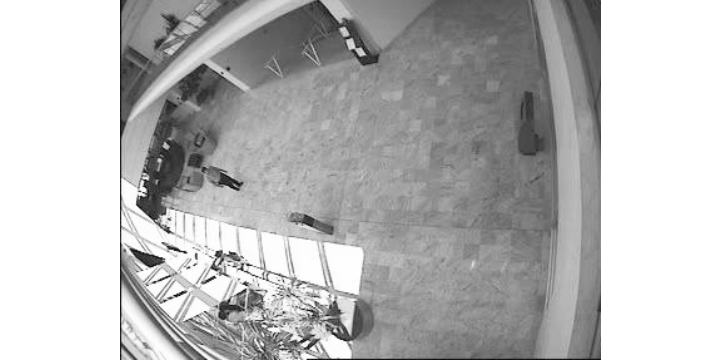
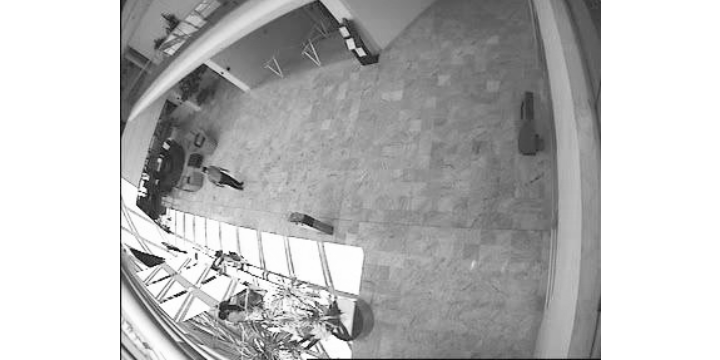
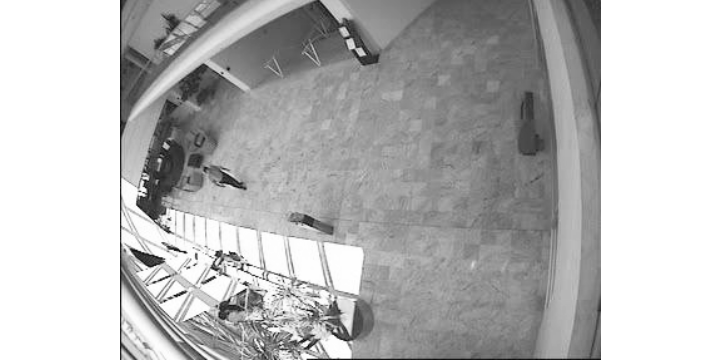
...
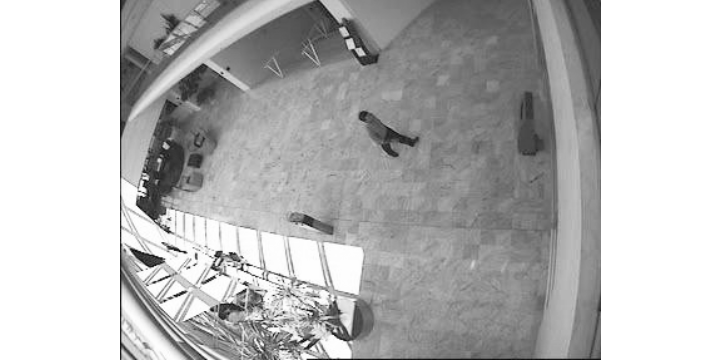
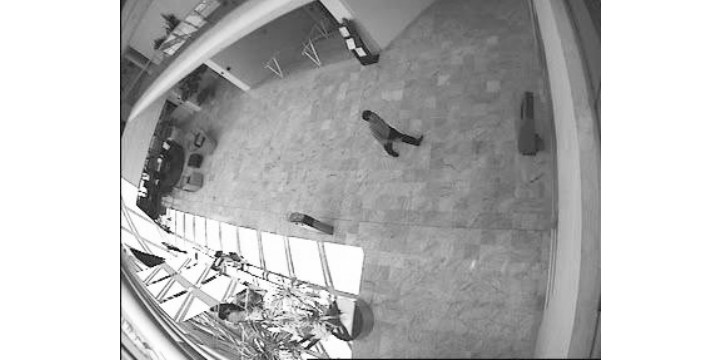
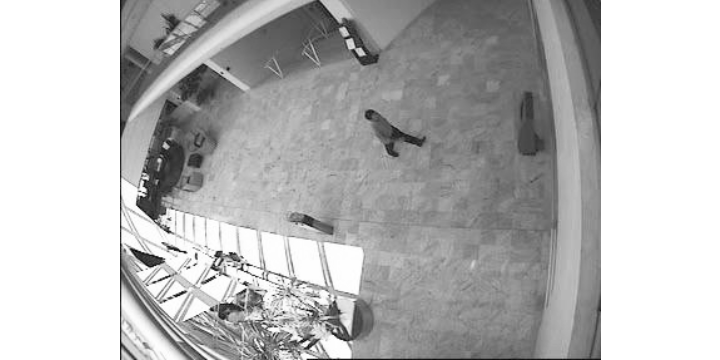
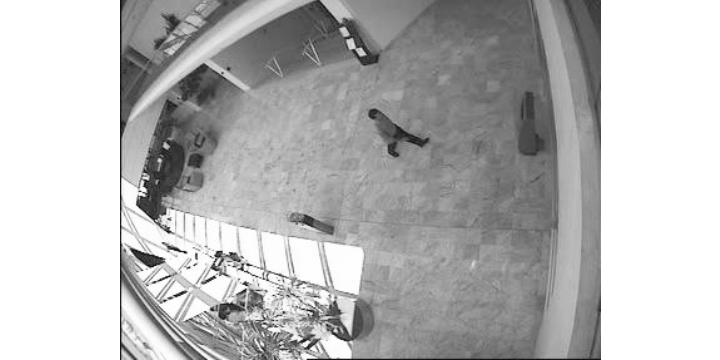
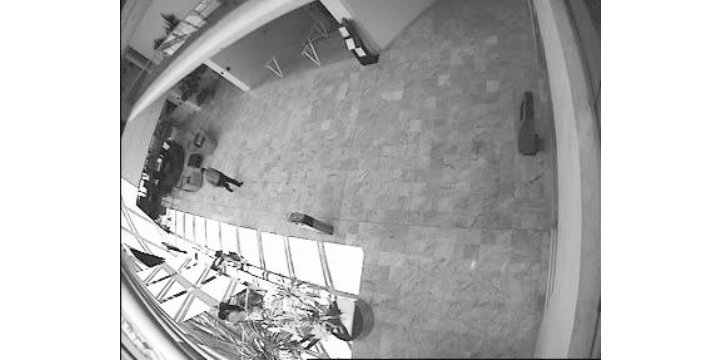

In [6]:
filenames=sorted(glob.glob('imgs/walk*.pgm'))

fig = plt.figure(figsize=(10,5))
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
im = plt.imshow(Image.open(filenames[0]), cmap = cm.Greys_r)

def init():
    im.set_data(Image.open(filenames[0]))
    return im,

def animate(i):
    image=Image.open(filenames[i])
    im.set_data(image)
    return im,

anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=101, interval=20, blit=True)

anim.save('original.html', writer=HTMLWriter(embed_frames=True))

anim


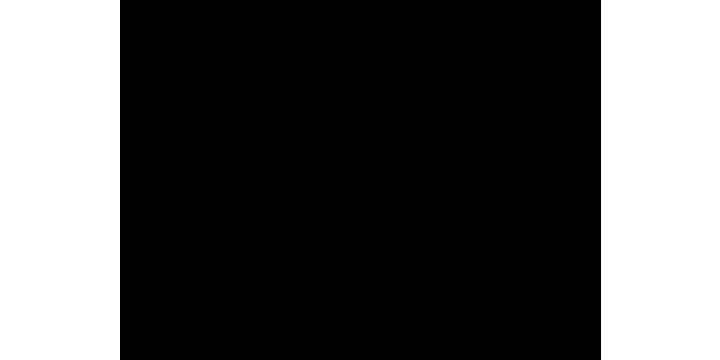
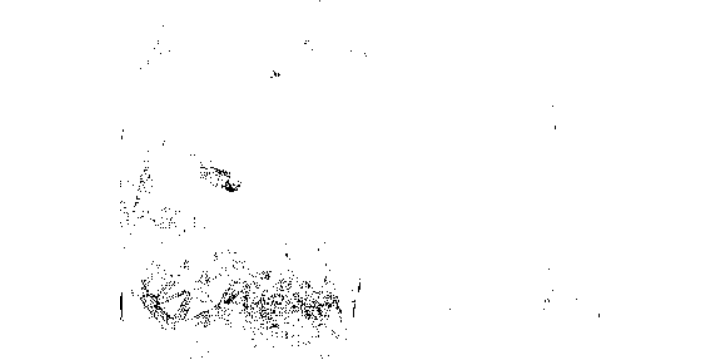
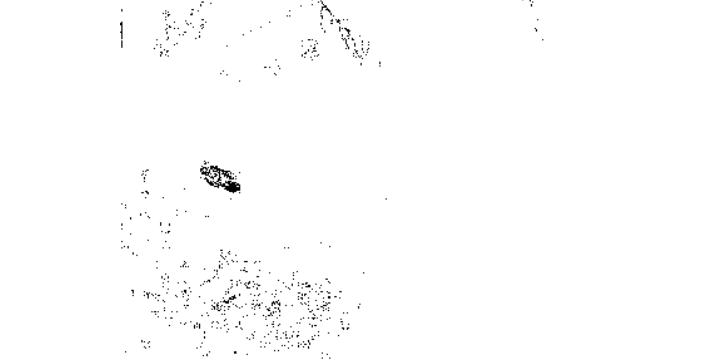
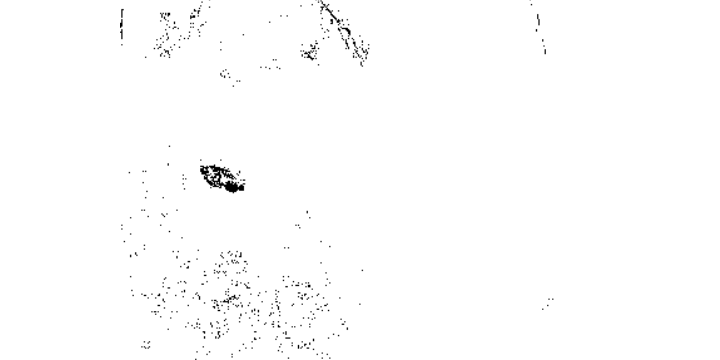
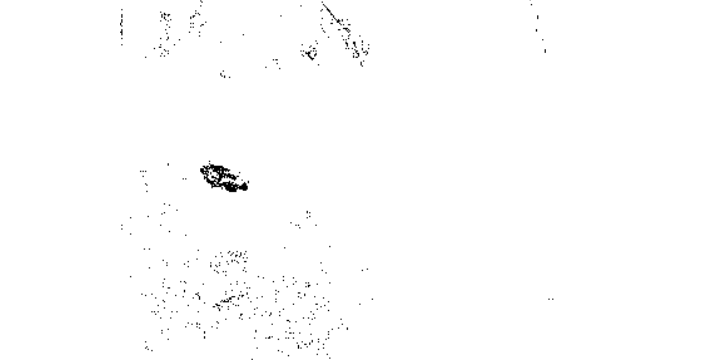
...
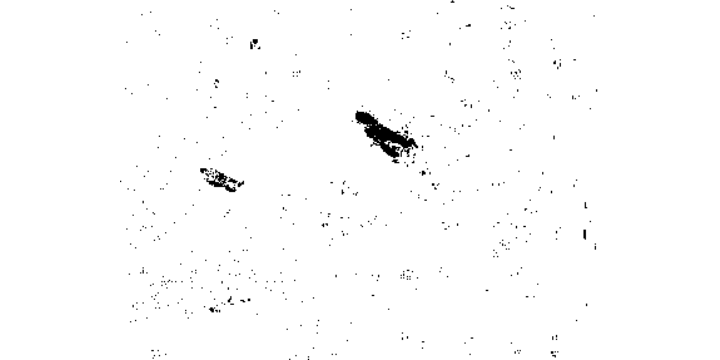
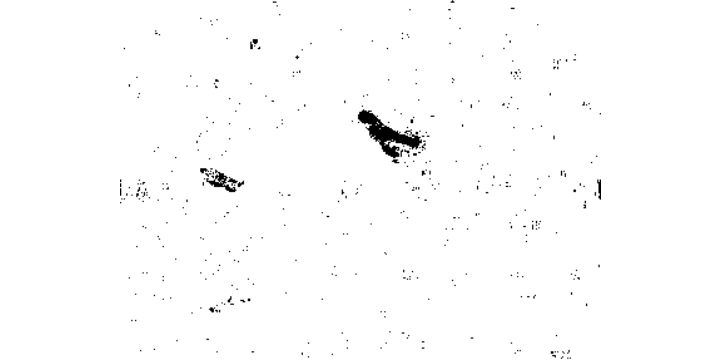
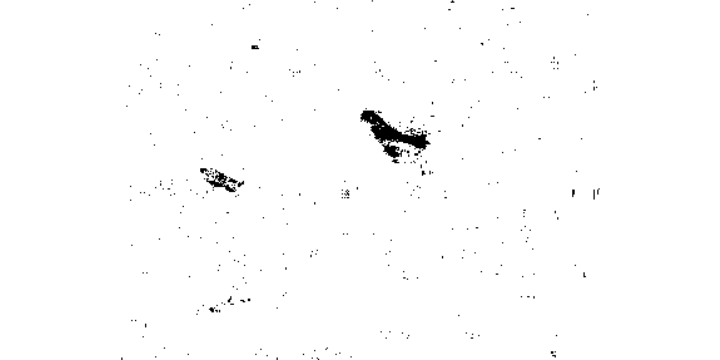
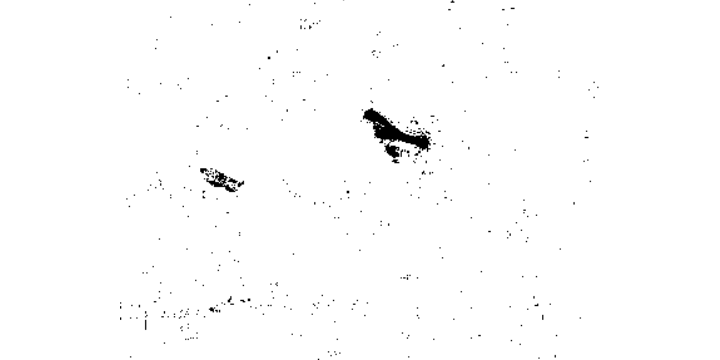
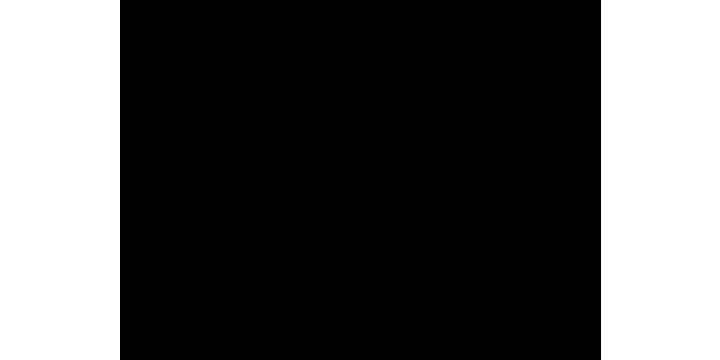

In [7]:
fig = plt.figure(figsize=(10,5))
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
im = plt.imshow(background[1], cmap = cm.Greys_r)
    
def init():
    im.set_data(background[1])
    return im,
    
def animate(i):
    im.set_data(background[i])
    return im,
    
anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=100, interval=20, blit=True)
    
anim.save('background.html', writer=HTMLWriter(embed_frames=True))

anim

### Salvar todas las imagenes 

In [8]:
for b in range(len(background)):
    imsave(join('background_imgs','outfile_' + str(b) + '.png'), background[b])